In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
from glob import iglob
import scrublet as scr
import anndata
import scanpy.external as sce
#import scrublet as scr # requires 'pip install scrublet'
import os
import sklearn
from sklearn.linear_model import LogisticRegression
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=100,dpi_save=800)  # low dpi (dots per inch) yields small inline figures

The `sinfo` package has changed name and is now called `session_info` to become more discoverable and self-explanatory. The `sinfo` PyPI package will be kept around to avoid breaking old installs and you can downgrade to 0.3.2 if you want to use it without seeing this message. For the latest features and bug fixes, please install `session_info` instead. The usage and defaults also changed slightly, so please review the latest README at https://gitlab.com/joelostblom/session_info.
-----
anndata     0.8.0
scanpy      1.6.0
sinfo       0.3.4
-----
PIL                         9.0.1
asciitree                   NA
asttokens                   NA
backcall                    0.2.0
beta_ufunc                  NA
binom_ufunc                 NA
bottleneck                  1.3.4
cairo                       1.21.0
cffi                        1.15.0
cloudpickle                 2.0.0
colorama                    0.4.4
cycler                      0.10.0
cython_runtime              NA
cytoolz            

In [3]:
adata = sc.read_h5ad('./cache/scRNA_merge.h5ad')

D:\conda\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [4]:
adata

AnnData object with n_obs × n_vars = 48156 × 22680
    obs: 'n_genes', 'ID', 'percent_mito', 'batch', 'n_counts', 'log_counts'
    var: 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'n_cells-2'

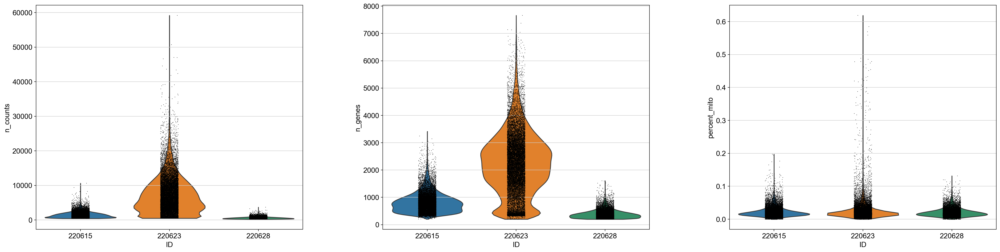

In [45]:
# Quality control - plot QC metrics
#Sample quality plots
plt.rcParams['figure.figsize']=(8,8)
t2 = sc.pl.violin(adata, ['n_counts','n_genes','percent_mito'], groupby='ID',save='qc_violin.pdf')

In [5]:
upper_lim = np.quantile(adata.obs.n_genes.values,.98)
lower_lim = np.quantile(adata.obs.n_genes.values,.02)
maxUMI = np.quantile(adata.obs.n_counts.values,.98)
print(f'{lower_lim} to {upper_lim}')
print(f'{maxUMI}')

221.0 to 4132.9000000000015
16623.900000000016


In [6]:
adata = adata[(adata.obs.n_genes < upper_lim)& (adata.obs.n_genes > lower_lim)]
adata = adata[adata.obs.n_counts <maxUMI]
adata = adata[adata.obs.percent_mito<0.1]

In [7]:
adata

View of AnnData object with n_obs × n_vars = 45562 × 22680
    obs: 'n_genes', 'ID', 'percent_mito', 'batch', 'n_counts', 'log_counts'
    var: 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'n_cells-1', 'gene_ids-2', 'feature_types-2', 'n_cells-2'

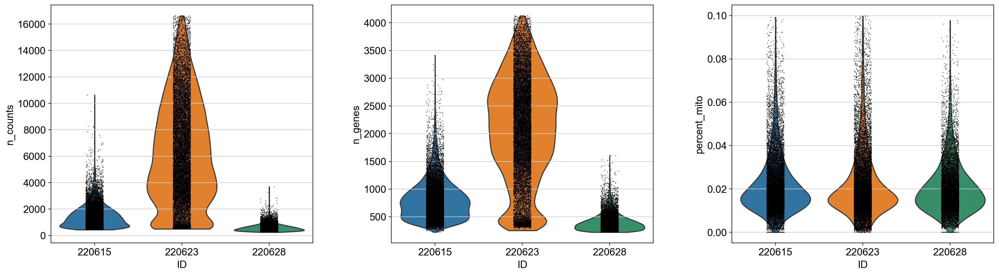

In [48]:
plt.rcParams['figure.figsize']=(6,6)
t3 = sc.pl.violin(adata, ['n_counts','n_genes','percent_mito'], groupby='ID')

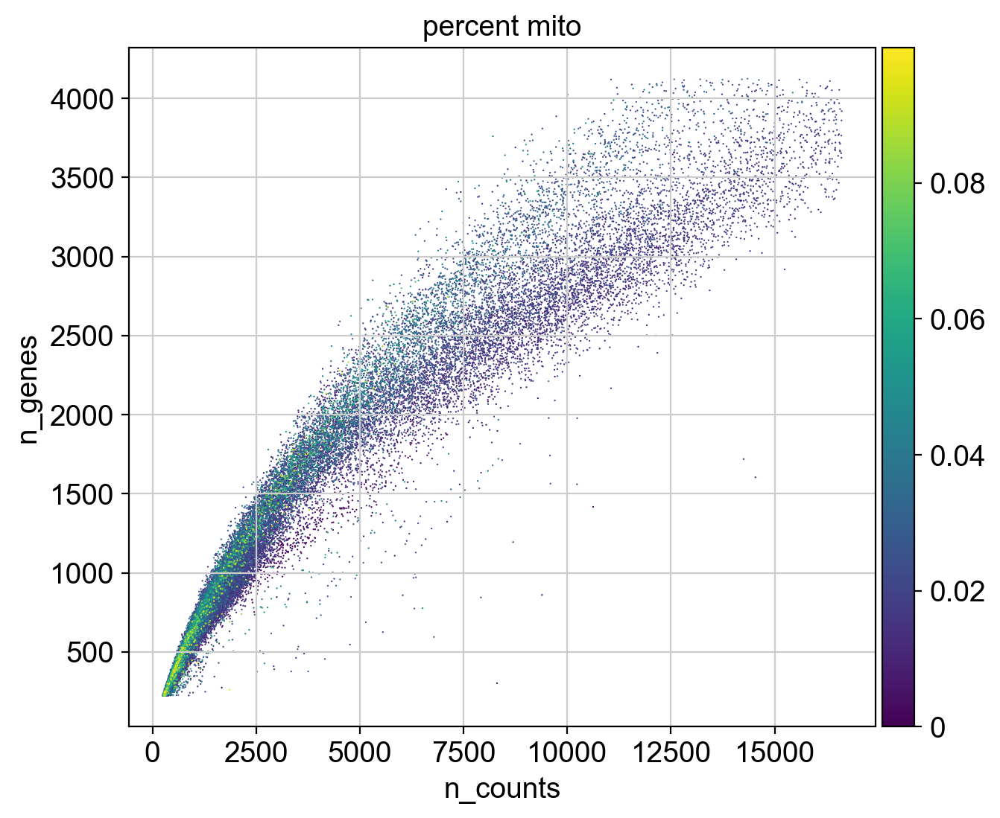

D:\conda\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


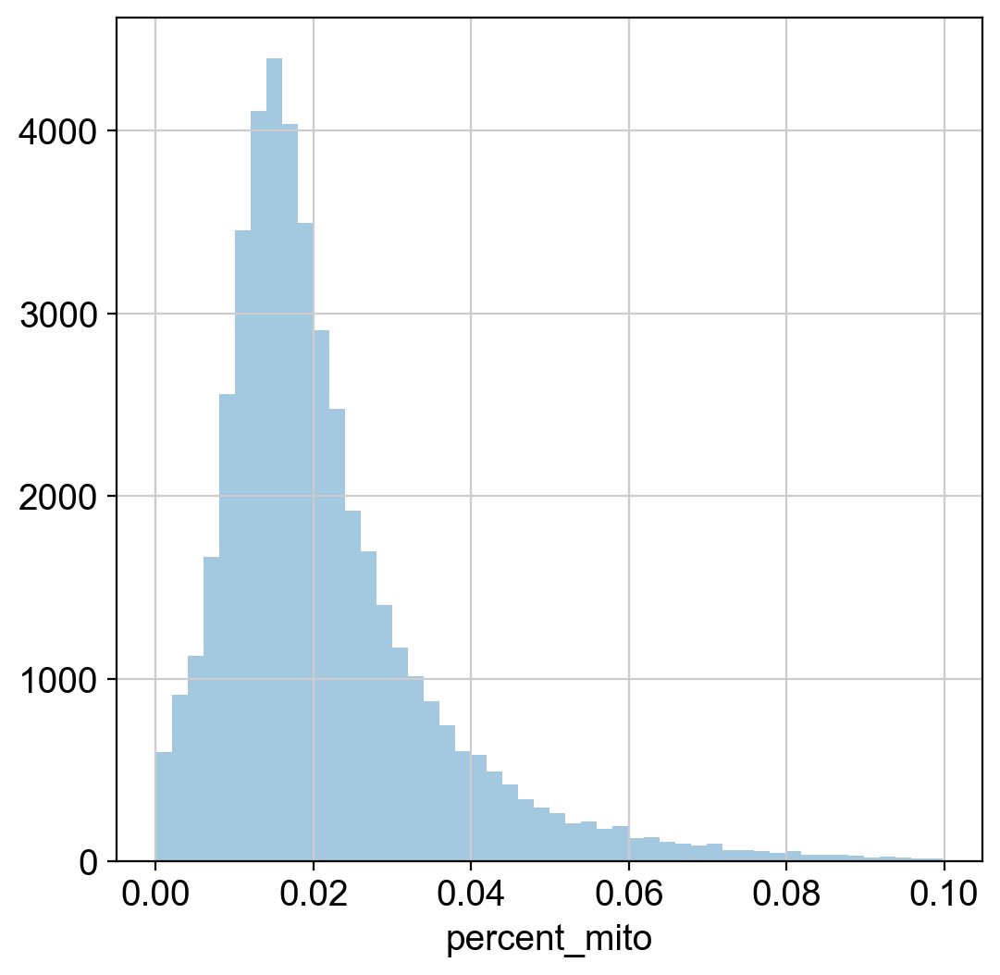

In [49]:
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes', color='percent_mito')
p2 = sns.distplot(adata.obs['percent_mito'], kde=False)

In [50]:
scrub = scr.Scrublet(adata.X)
adata.obs['doublet_scores'], adata.obs['predicted_doublets'] = scrub.scrub_doublets()

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.29
Detected doublet rate = 4.3%
Estimated detectable doublet fraction = 23.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 18.4%
Elapsed time: 70.2 seconds


C:\Users\scholar\AppData\Local\Temp\ipykernel_17624\1114294960.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_scores'], adata.obs['predicted_doublets'] = scrub.scrub_doublets()
D:\conda\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
D:\conda\lib\site-packages\anndata\_core\anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [51]:
num_predicted_doublets = sum(adata.obs['predicted_doublets'])
print(f"Predicted {num_predicted_doublets} doublets")

Predicted 1949 doublets


In [52]:
adata.obs['doublet_info'] = adata.obs["predicted_doublets"].astype(str)
adata.obs

,n_genes,ID,percent_mito,batch,n_counts,log_counts,doublet_scores,predicted_doublets,doublet_info
AAACCCAAGACCGCCT-1,614,220615,0.020630,0,921.0,6.825460,0.049921,False,False
AAACCCAAGCAAGTCG-1,1237,220615,0.014971,0,2271.0,7.727975,0.091308,False,False
AAACCCAAGGGAGGTG-1,668,220615,0.008014,0,1123.0,7.023759,0.075294,False,False
AAACCCAAGGTCACTT-1,1295,220615,0.017918,0,2623.0,7.872074,0.089100,False,False
AAACCCAAGTCGCCCA-1,842,220615,0.012138,0,1483.0,7.301822,0.199095,False,False
...,...,...,...,...,...,...,...,...,...
TTTGTTGGTCGCGTTG-1,438,220628,0.029617,2,574.0,6.352629,0.079919,False,False
TTTGTTGGTGCCTGAC-1,264,220628,0.026866,2,335.0,5.814131,0.041765,False,False
TTTGTTGGTTCAAACC-1,342,220628,0.016432,2,426.0,6.054440,0.074406,False,False
TTTGTTGGTTTCGCTC-1,362,220628,0.021956,2,501.0,6.216606,0.108824,False,False


In [1]:
sc.pl.violin(adata, 'n_genes',
             jitter=0.4, groupby = 'doublet_info', rotation=45,save='doublet_delete.pdf')

NameError: name 'sc' is not defined

In [31]:
adata = adata[adata.obs['doublet_info'] == 'False',:]
print(adata.shape)

(43613, 22680)


In [54]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

normalizing counts per cell
    finished (0:00:00)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
Highly variable genes: 3814


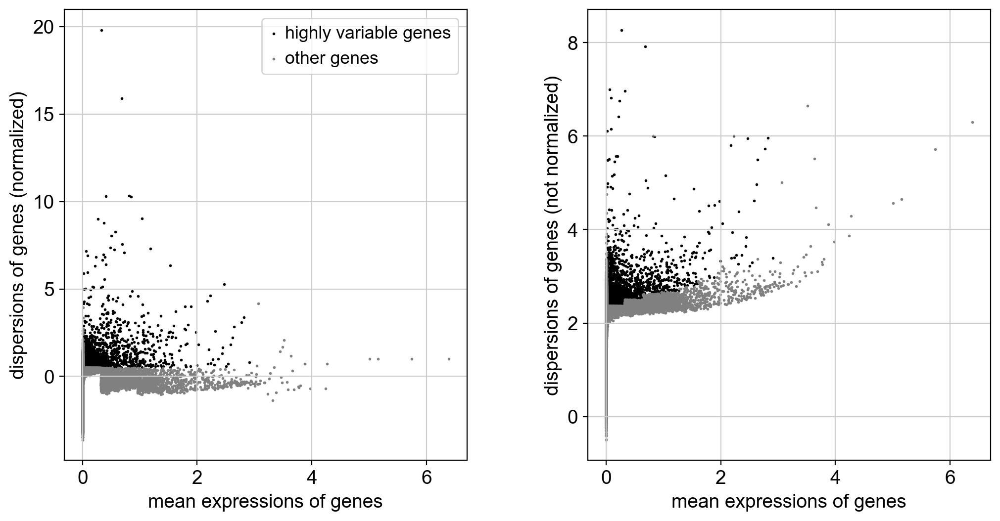

In [55]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
print("Highly variable genes: %d"%sum(adata.var.highly_variable))
sc.pl.highly_variable_genes(adata,save='_filter.pdf')

In [56]:
#adata = adata[:, adata.var.highly_variable]
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])
sc.pp.scale(adata, max_value=10)

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:11:05)


computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:07)


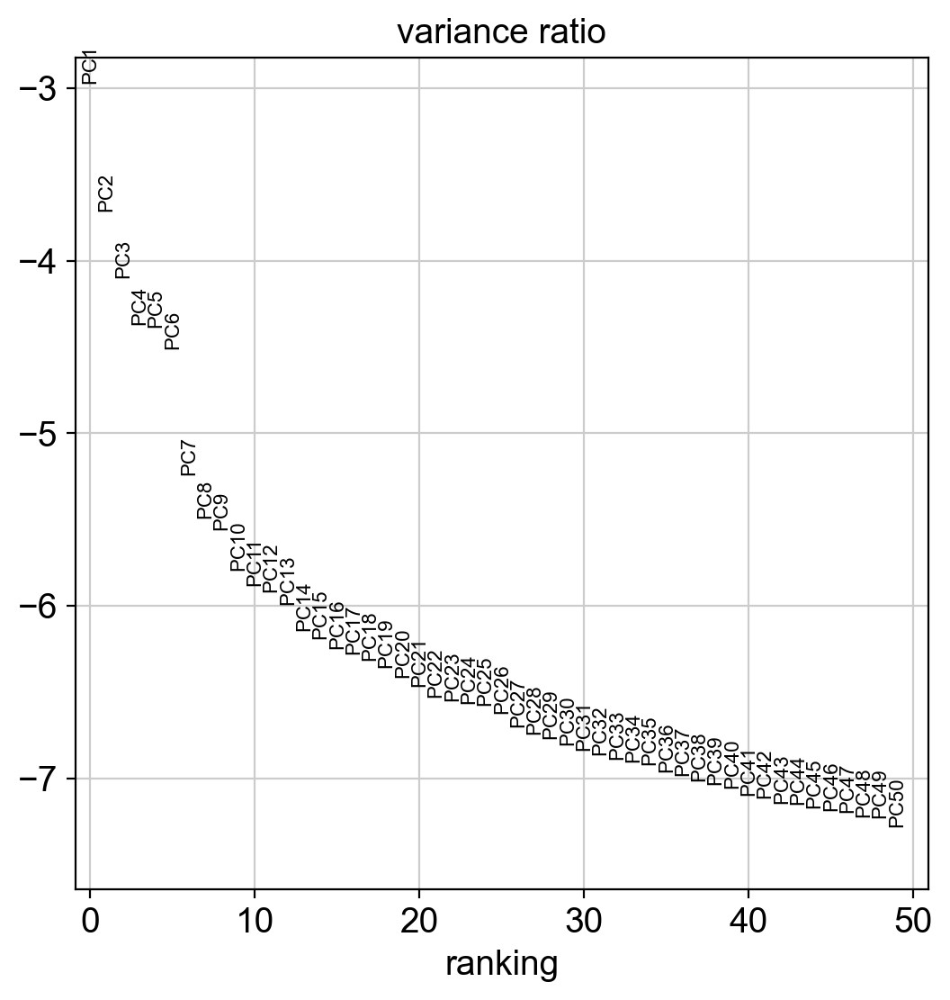

<AxesSubplot:>

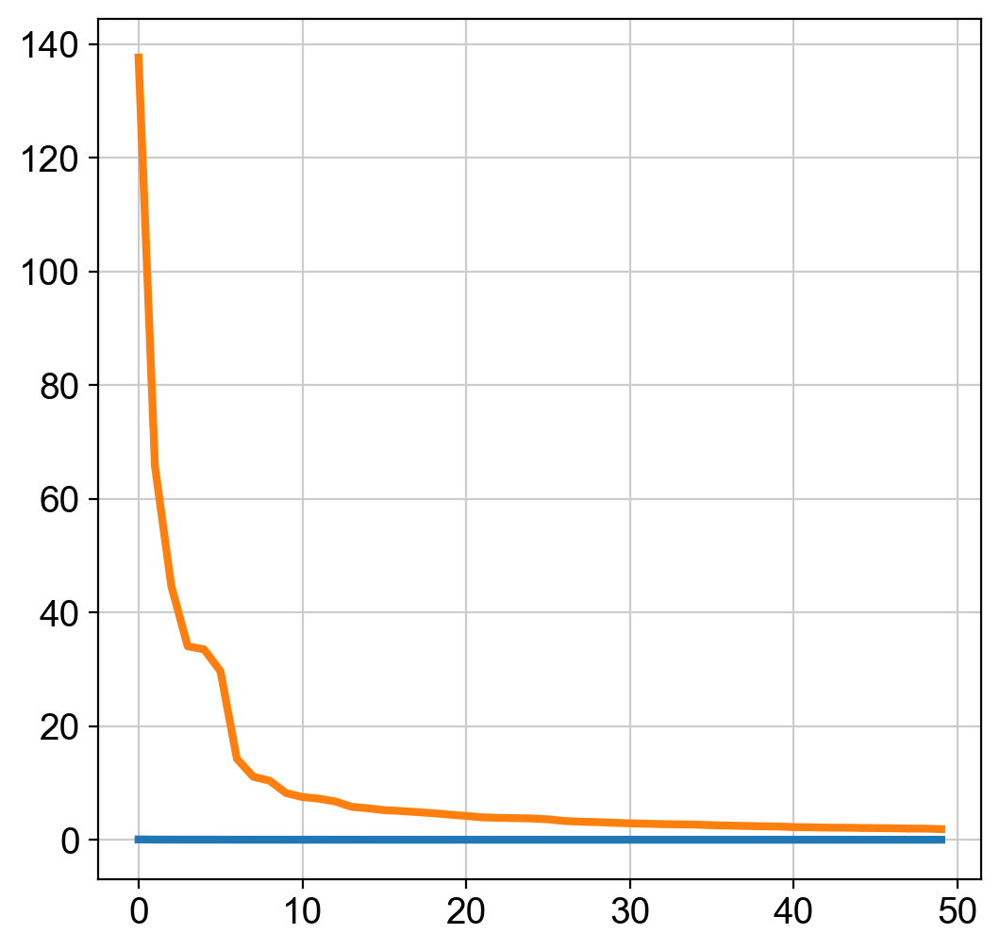

In [57]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True,n_pcs = 50)
sns.lineplot(data = adata.uns['pca']['variance_ratio'],palette= 'tab10',linewidth = 3)
adata.uns['pca']['variance']
sns.lineplot(data =adata.uns['pca']['variance'],palette='tab10',linewidth = 3)

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:18)
neighbors的数值为：10


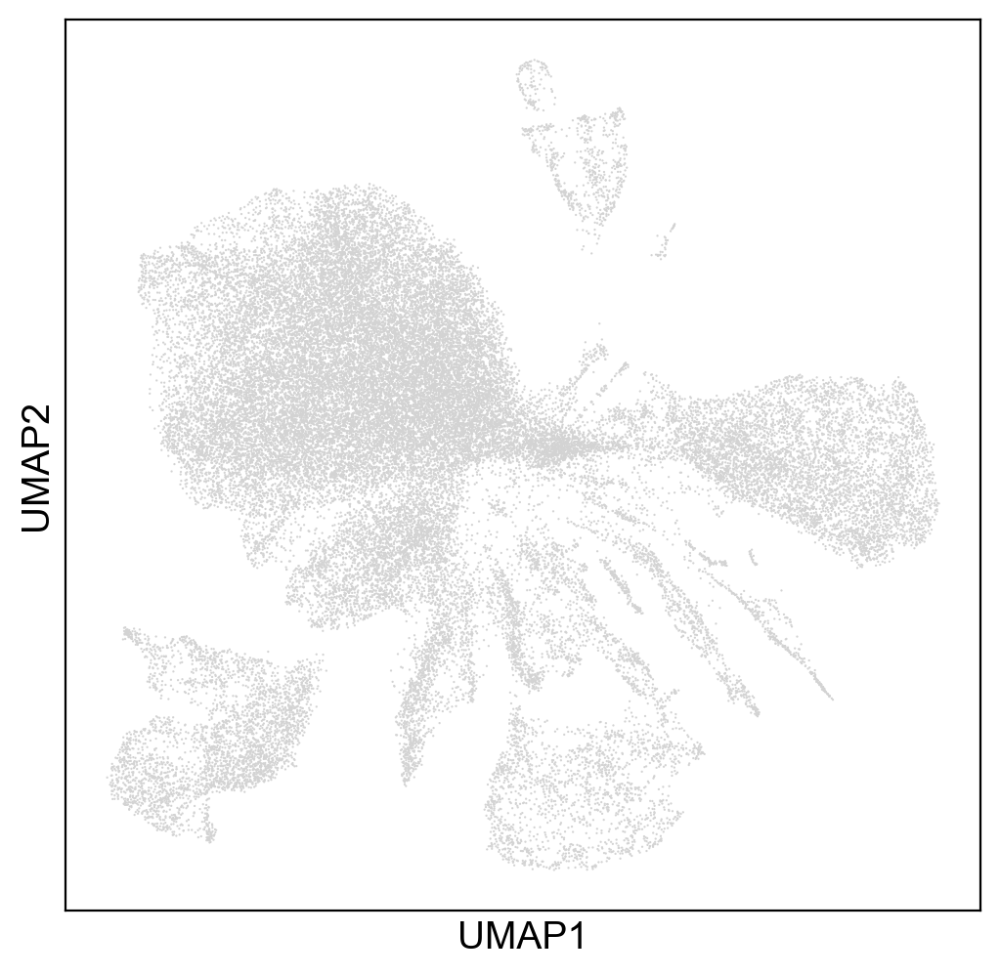

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:21)
neighbors的数值为：15


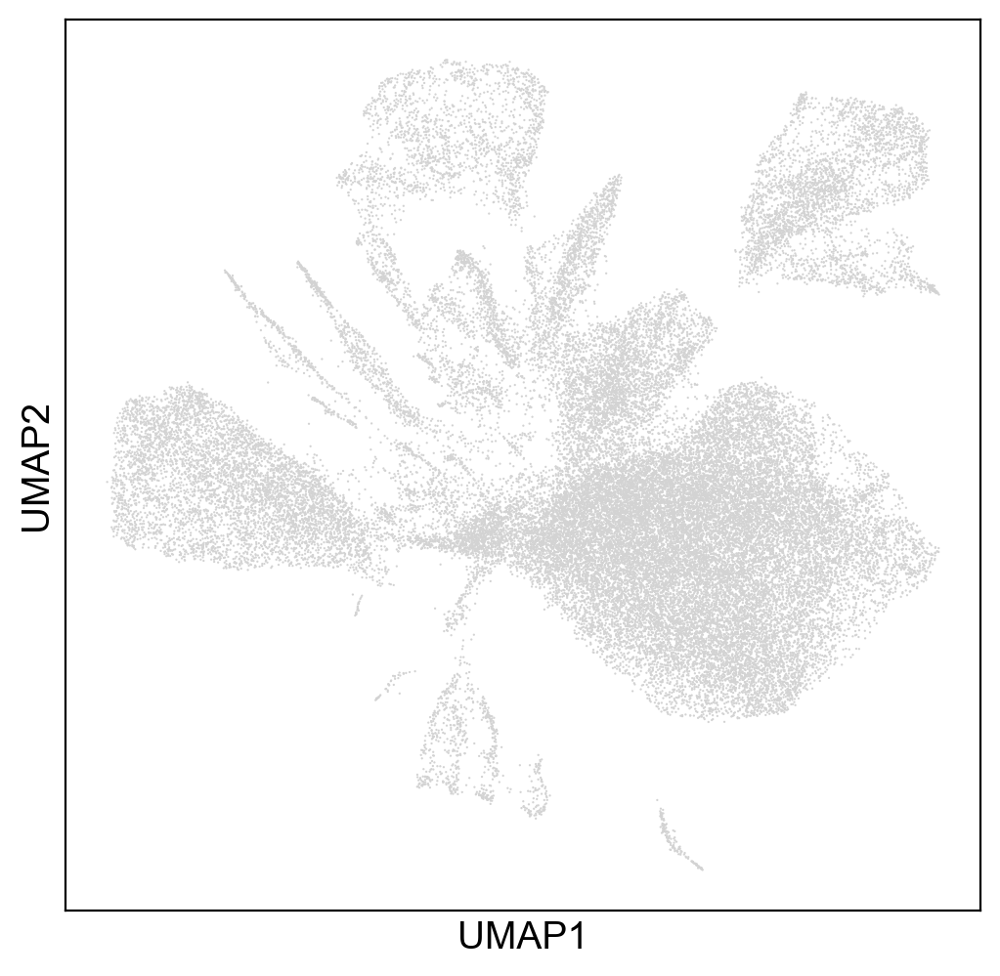

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:23)
neighbors的数值为：20


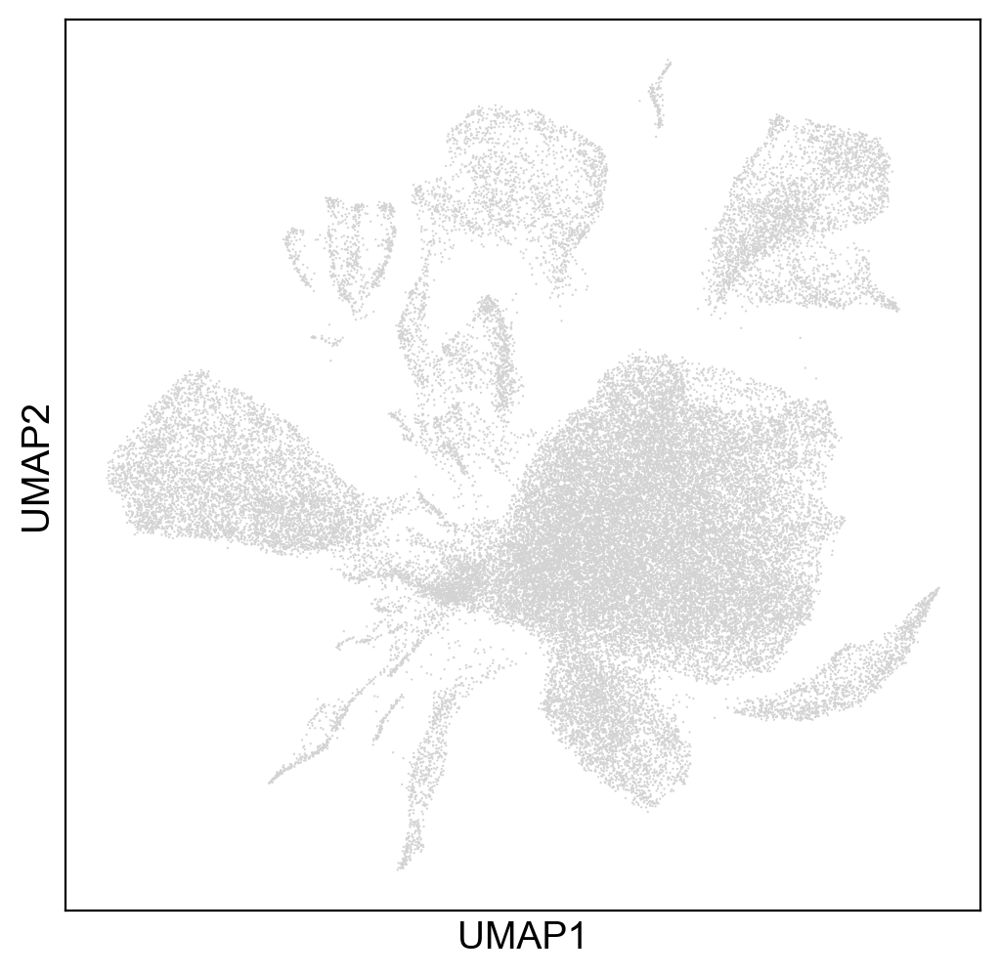

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
neighbors的数值为：25


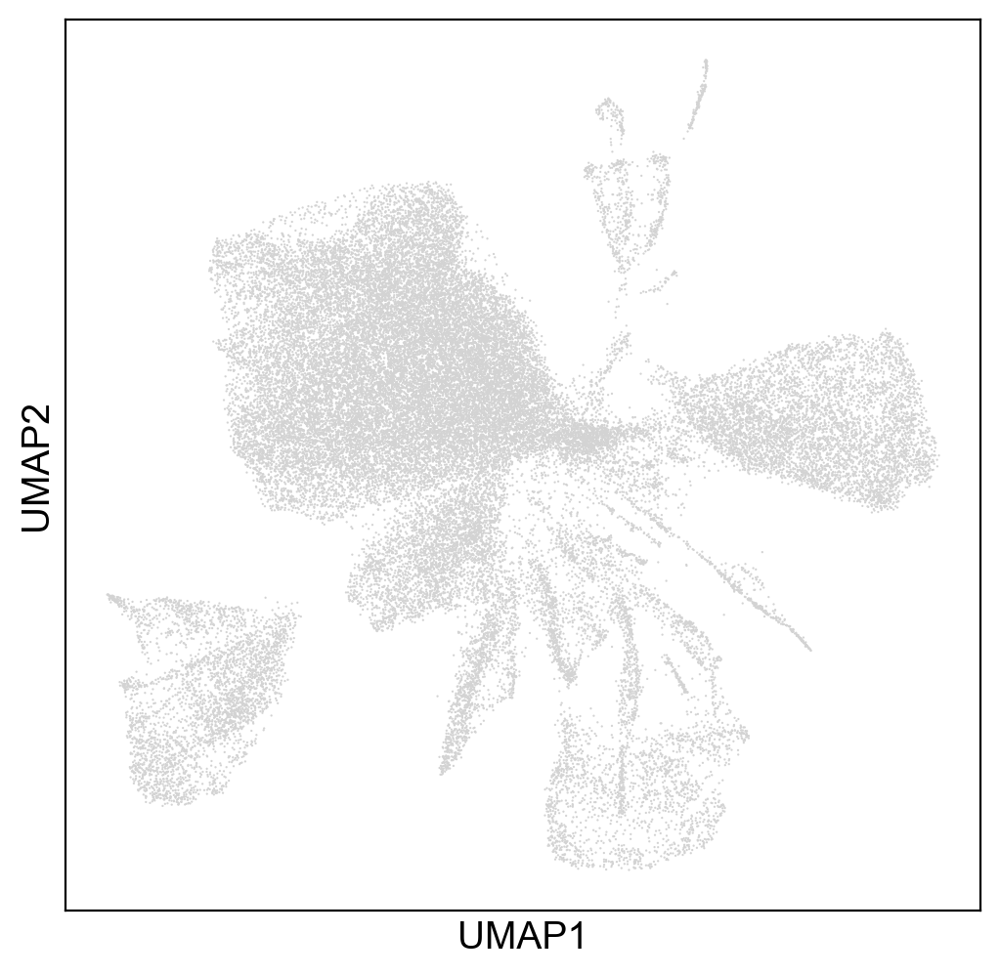

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:25)
neighbors的数值为：30


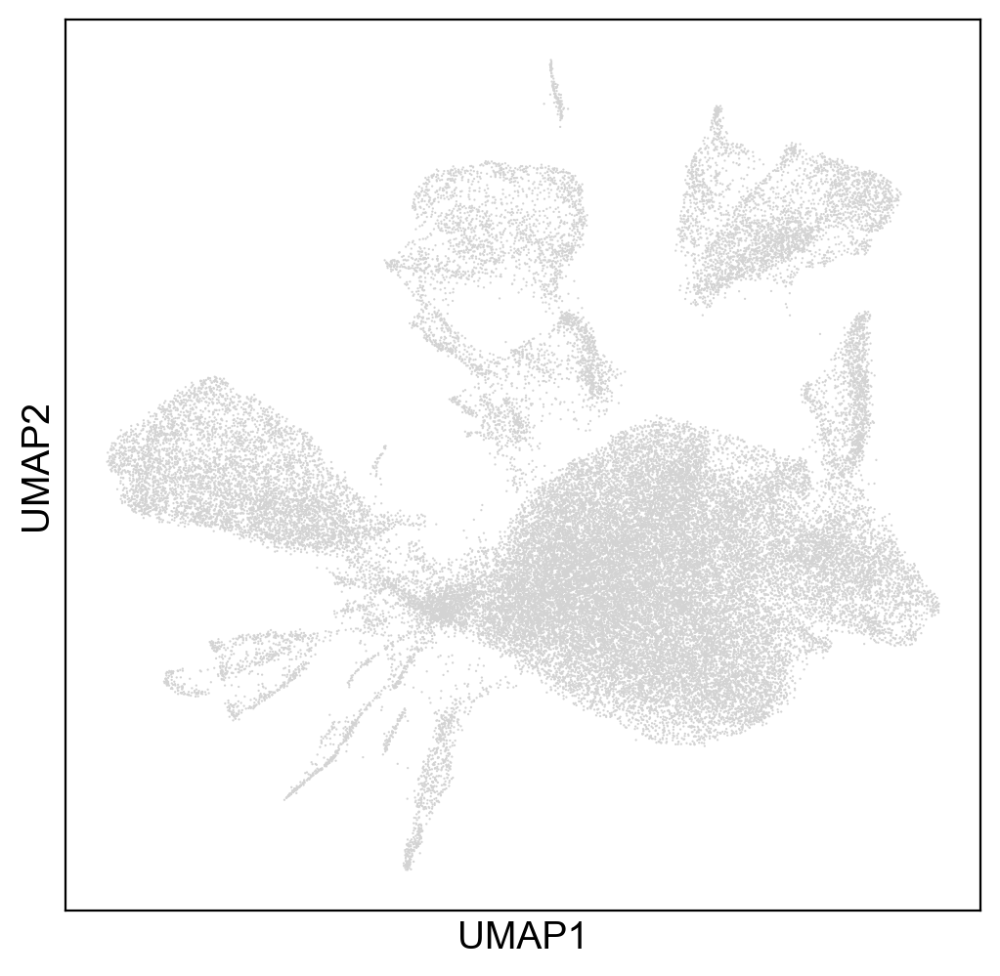

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:26)
neighbors的数值为：35


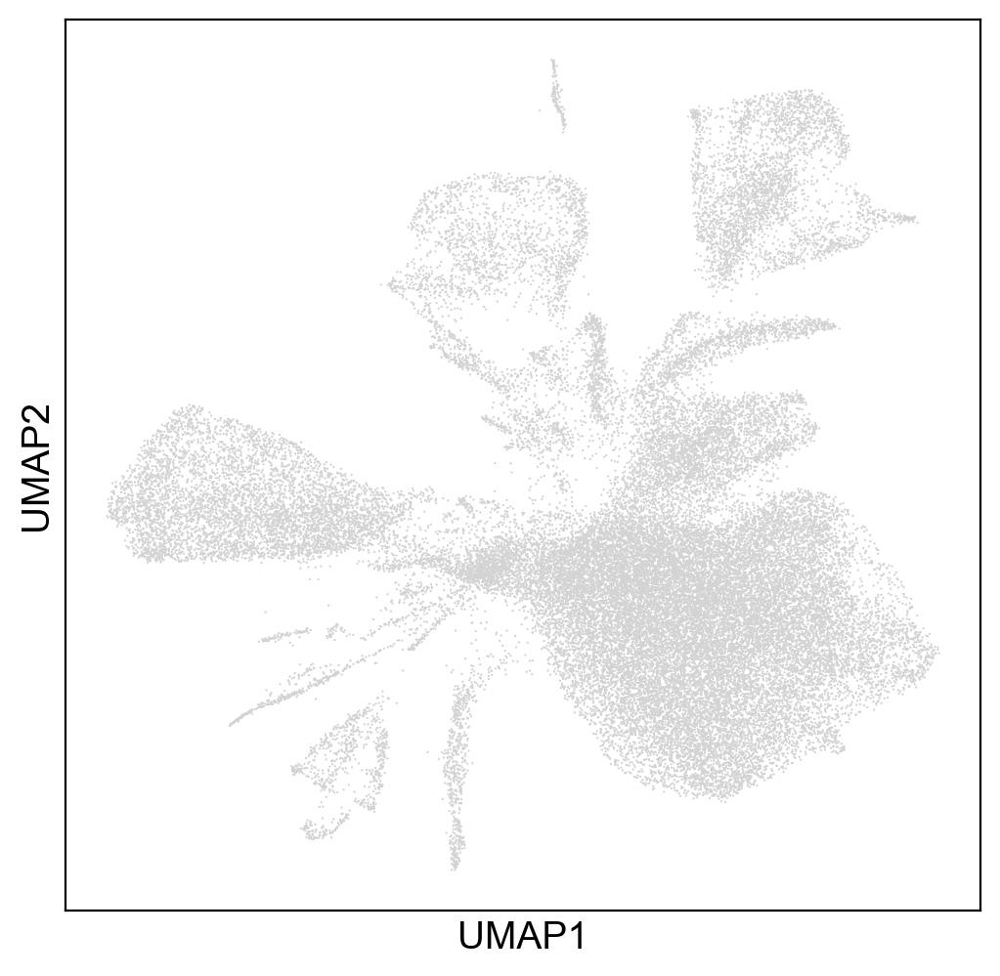

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:28)
neighbors的数值为：40


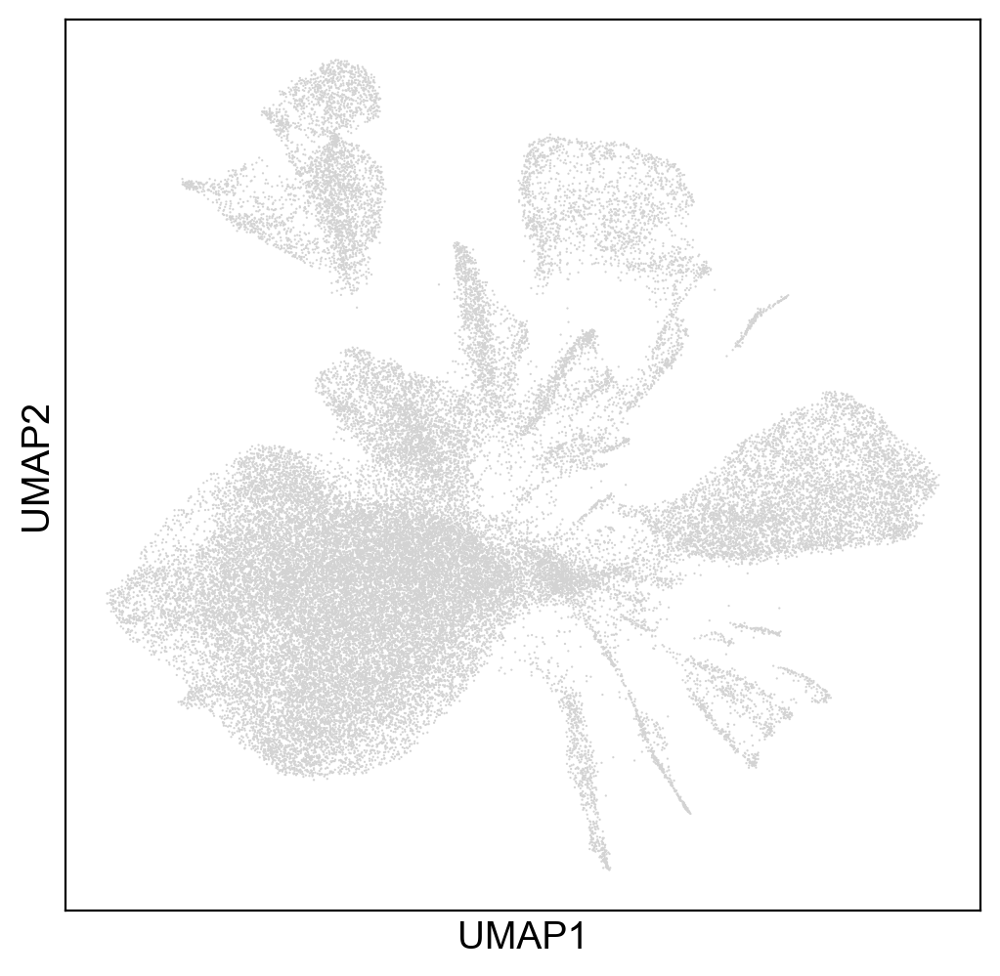

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)
neighbors的数值为：45


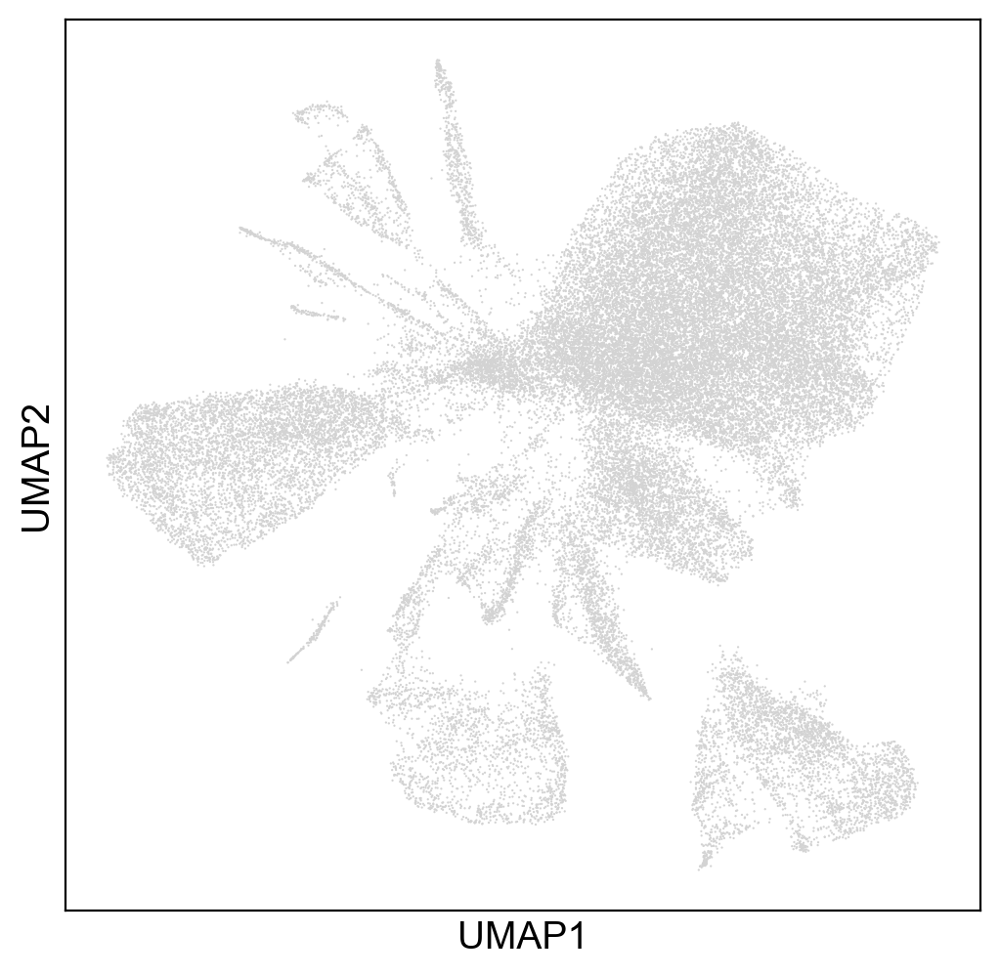

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:05)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)
neighbors的数值为：50


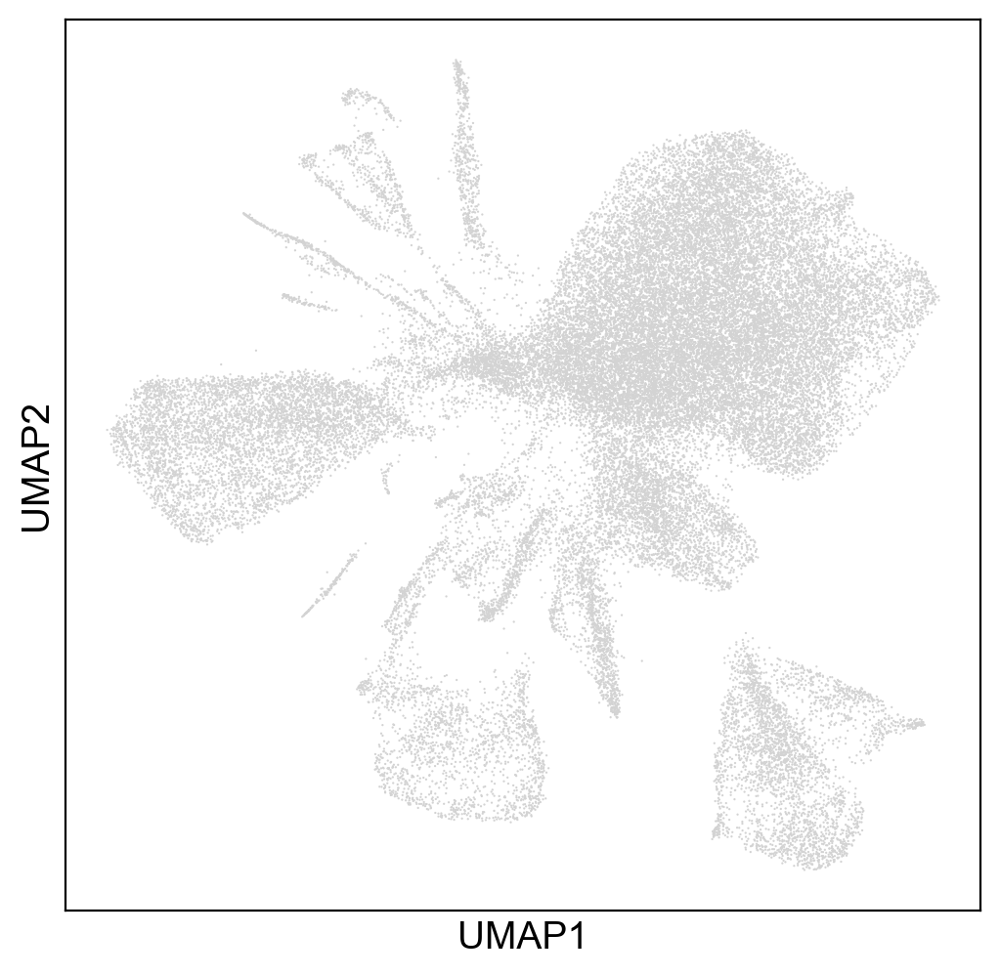

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)
neighbors的数值为：55


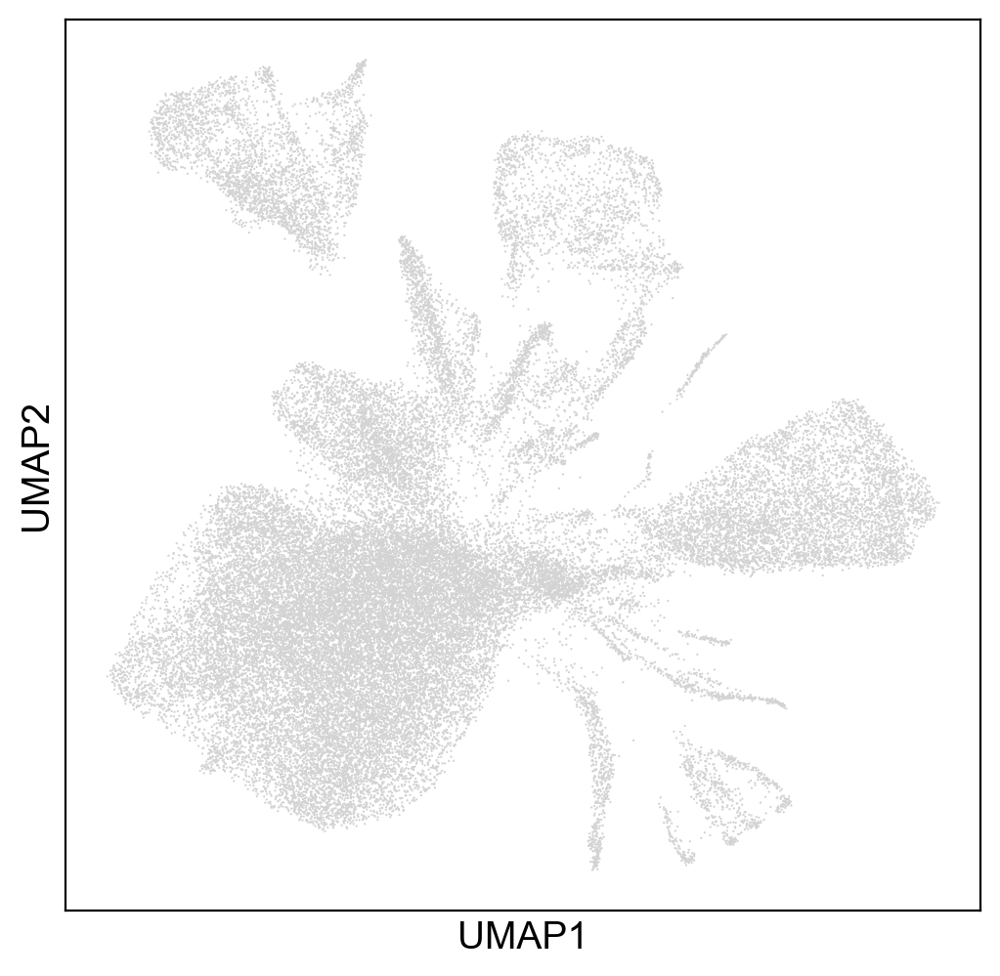

In [58]:
for i in range(10,60,5):
    sc.pp.neighbors(adata,n_pcs=30, n_neighbors= i)
    sc.tl.umap(adata)
    print(f'neighbors的数值为：{i}')
    sc.pl.umap(adata)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:04)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:29)


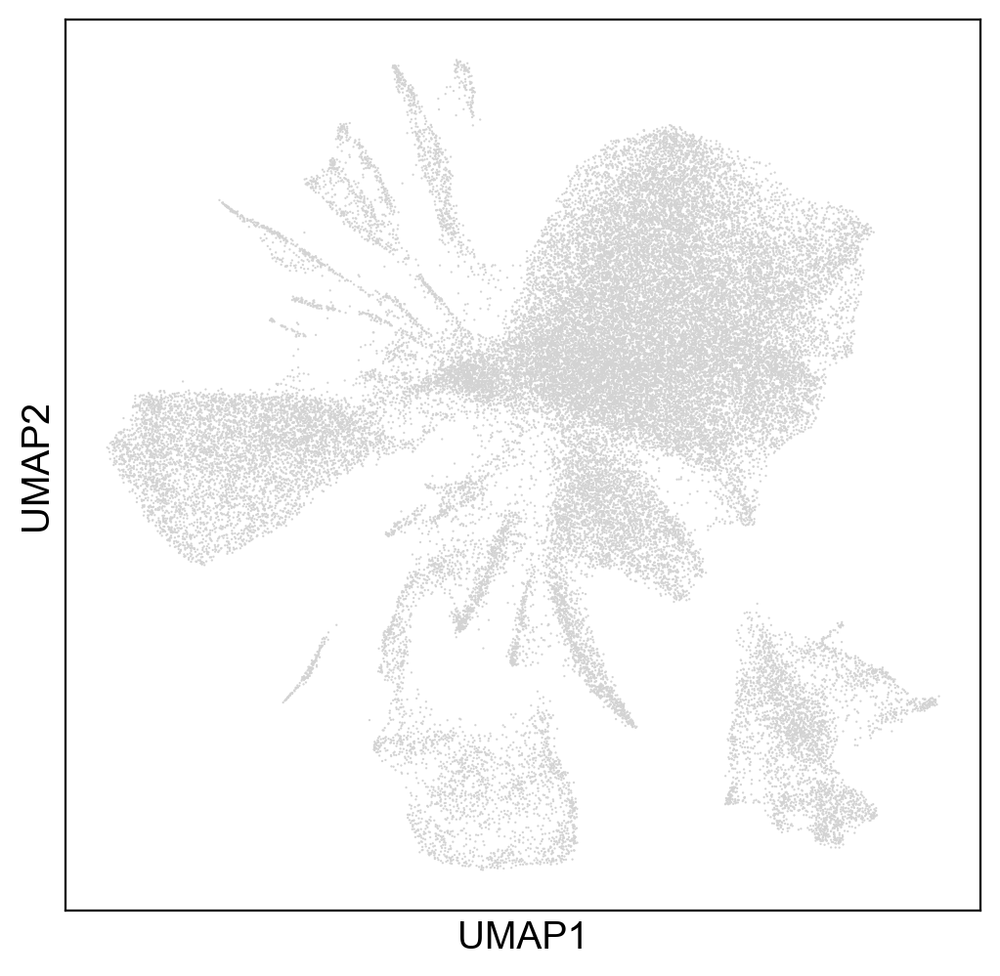

In [59]:
sc.pp.neighbors(adata,n_pcs=40, n_neighbors= 45)
sc.tl.umap(adata)
sc.pl.umap(adata)

In [60]:
for i in range(1,16):
    sc.tl.leiden(adata,resolution=round(i*0.1,1),key_added=f'cluster_{round(i*0.1,1)}')

running Leiden clustering
    finished: found 9 clusters and added
    'cluster_0.1', the cluster labels (adata.obs, categorical) (0:00:29)
running Leiden clustering
    finished: found 10 clusters and added
    'cluster_0.2', the cluster labels (adata.obs, categorical) (0:00:25)
running Leiden clustering
    finished: found 14 clusters and added
    'cluster_0.3', the cluster labels (adata.obs, categorical) (0:00:42)
running Leiden clustering
    finished: found 16 clusters and added
    'cluster_0.4', the cluster labels (adata.obs, categorical) (0:00:36)
running Leiden clustering
    finished: found 16 clusters and added
    'cluster_0.5', the cluster labels (adata.obs, categorical) (0:00:41)
running Leiden clustering
    finished: found 18 clusters and added
    'cluster_0.6', the cluster labels (adata.obs, categorical) (0:01:07)
running Leiden clustering
    finished: found 20 clusters and added
    'cluster_0.7', the cluster labels (adata.obs, categorical) (0:00:55)
running Leiden

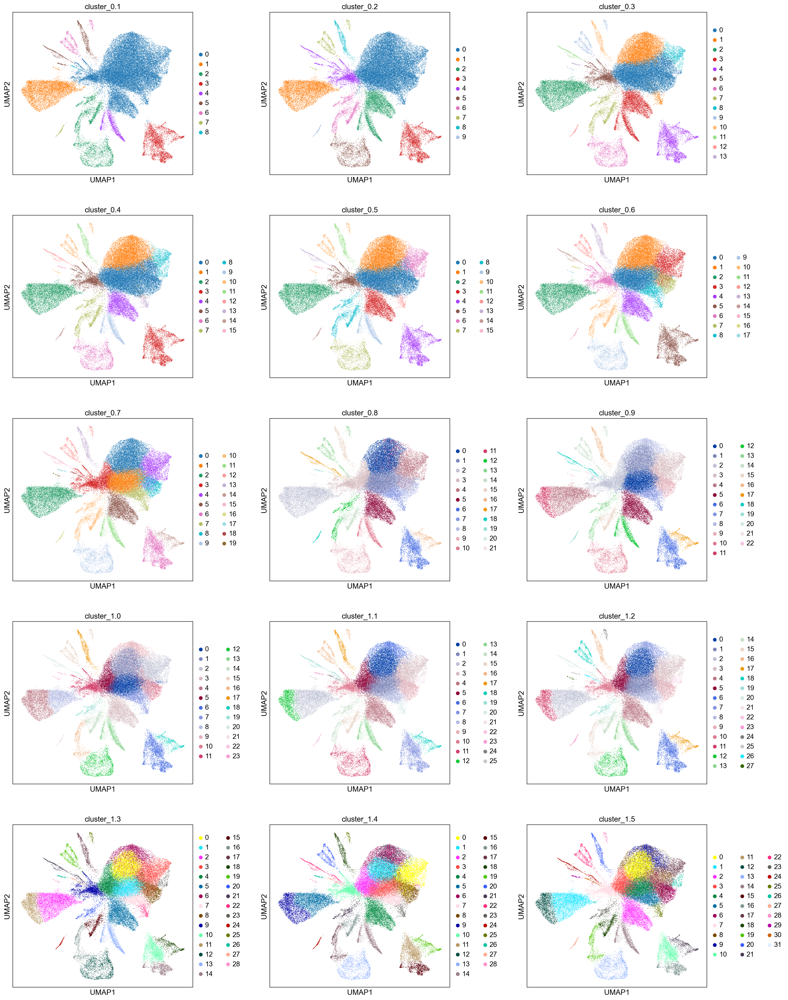

In [61]:
sc.pl.umap(adata,color = [f'cluster_{round(i*0.1,1)}' for i in range(1,16)],ncols = 3,wspace=0.3)

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:03:50)


D:\conda\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
D:\conda\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
D:\conda\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
D:\conda\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
D:\conda\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
D:\conda\lib\site-packages\scanpy\tools\_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'lo

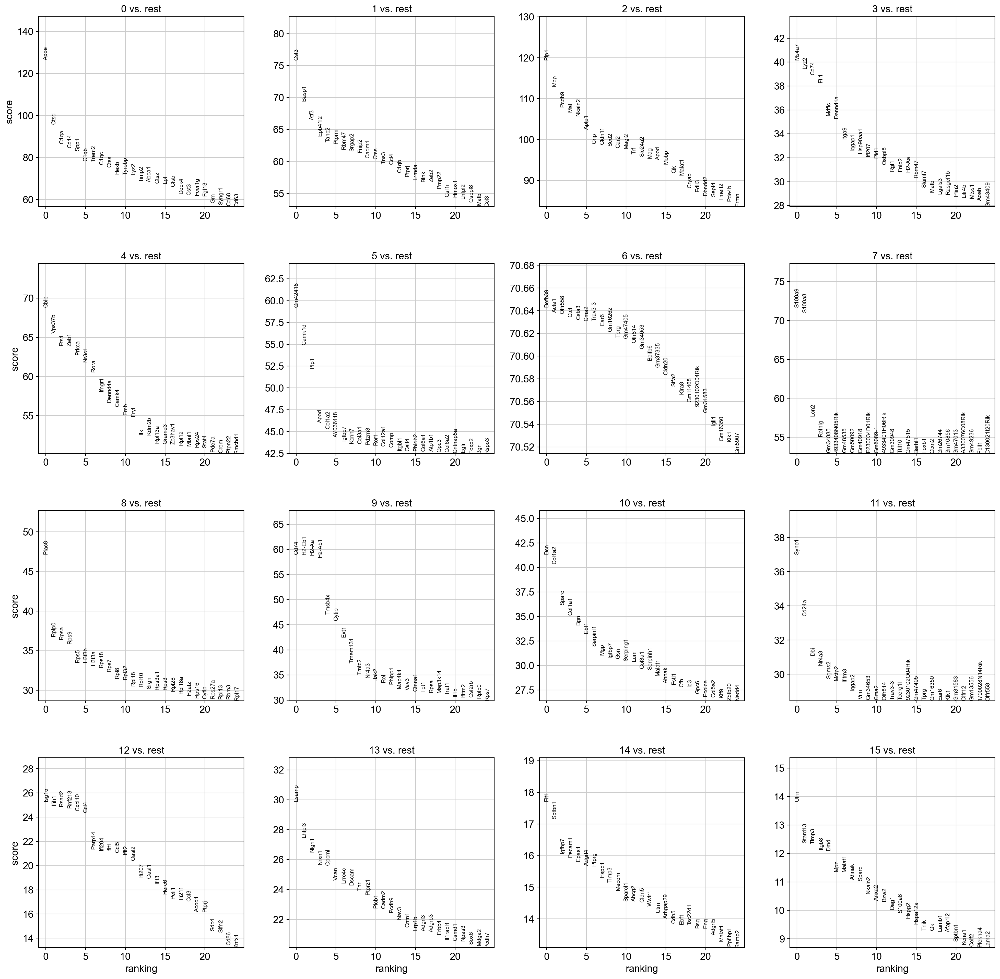

In [62]:
sc.tl.rank_genes_groups(adata,'cluster_0.5',method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [63]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(25)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,Apoe,Cst3,Plp1,Ms4a7,Cblb,Gm42418,Defb39,S100a9,Plac8,Cd74,Dcn,Syne1,Isg15,Lsamp,Flt1,Utrn
1,Ctsd,Basp1,Mbp,Lyz2,Vps37b,Camk1d,Acta1,S100a8,Rplp0,H2-Eb1,Col1a2,Cd24a,Ifih1,Lhfpl3,Sptbn1,Stard13
2,C1qa,Atf3,Pcdh9,Cd74,Ets1,Plp1,Olfr558,Lcn2,Rpsa,H2-Aa,Sparc,Dbi,Rsad2,Nlgn1,Igfbp7,Timp3
3,Cd14,Epb41l2,Mal,Ftl1,Zeb1,Apod,Ctcfl,Retnlg,Rps9,H2-Ab1,Col1a1,Nr4a3,Rnf213,Nrxn1,Pecam1,Itgb8
4,Spp1,Tanc2,Nkain2,Mdfic,Prkca,Col1a2,Csta3,Gm34885,Rps5,Tmsb4x,Bgn,Sgms2,Cxcl10,Opcml,Epas1,Dmd
5,C1qb,Ptprm,Aplp1,Dennd1a,Nr3c1,AY036118,Cma2,4933408N05Rik,H3f3b,Cytip,Ebf1,Mctp2,Ccl4,Vcan,Adgrl4,Mpz
6,Trem2,Rbm47,Cnp,Itga9,Rora,Igfbp7,Trav3-3,Gm48535,H3f3a,Ext1,Serpinf1,Ifitm3,Parp14,Lrrc4c,Ptprg,Malat1
7,C1qc,Srgap2,Cldn11,Iqgap1,Ifngr1,Kcnh7,Ear6,Gm50092,Rps18,Tmem131,Mgp,Iqgap2,Ifi204,Dscam,Hspb1,Ahnak
8,Ctss,Fnip2,Scd2,Hsp90aa1,Dennd4a,Col3a1,Gm16262,Gm40918,Rps7,Tmtc2,Igfbp7,Vim,Ifit1,Tnr,Timp3,Sparc
9,Hexb,Cadm1,Car2,Ifi207,Camk4,Pdzrn3,Tprg,E230034D01Rik,Rpl8,Nr4a3,Gsn,Gm34653,Ccl5,Ptprz1,Mecom,Nkain2


In [64]:
adata.write('./cache/scRNA_cluster.h5ad')